# 1. Define problem

In [1]:
from sklearn.impute import KNNImputer
from sklearn.ensemble import RandomForestClassifier, IsolationForest
from sklearn.metrics import make_scorer, accuracy_score, f1_score, roc_auc_score
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# 2. Data Preprocessing

In [2]:
raw_data = pd.read_csv('interview-task-2.csv')
categorical_cols = ['brand', 'city']
day_cols = ['publish_day', 'archive_day']
hour_cols = ['publish_hour', 'archive_hour']
numerical_cols = ['image_count', 'view_count', 'get_contact_count']

class transformation:
    def __init__(self, data):
        self.data = data

    def fill_na_columns(self,columns=['archive_day', 'archive_hour']):
        X, y = self.create_X_y()
        imputer = KNNImputer(n_neighbors=7)
        imputed_X = imputer.fit_transform(X)
        new_data = pd.DataFrame(np.column_stack((imputed_X, y)), columns=self.data.columns)

        for column in columns:
            new_data[column] = new_data[column].round()

        self.data = new_data
        return self

    def drop_columns(self, columns):
        # to_dropped = list(set(columns).intersection(set(self.data.columns)))
        self.data = self.data.drop(columns, axis=1)
        return self

    def drop_na_columns(self):
        self.data = self.data.dropna(axis=1)
        return self

    def drop_na_rows(self):
        self.data = self.data.dropna(axis=0)
        return self

    def cats_to_one_hot(self, columns):
        self.data = pd.get_dummies(self.data, columns=columns)
        return self

    def add_published_duration(self):
        new_df = self.data.copy()
        new_df['duration'] = self.data['archive_day'] - \
            self.data['publish_day']

        self.data = new_df
        return self

    def times_to_period(self, hours=None, days=None):
        new_df = self.data.copy()
        pi = 3.14
        if hours:
            for hour in hours:
                new_df[f'xh_{hour}'] = new_df[hour].apply(
                    lambda hr: np.sin(2*pi*hr/24))
                new_df[f'yh_{hour}'] = new_df[hour].apply(
                    lambda hr: np.cos(2*pi*hr/24))
                del new_df[hour]
        if days:
            for day in days:
                new_df[f'xh_{day}'] = new_df[day].apply(
                    lambda day: np.sin(2*pi*day/30))
                new_df[f'yh_{day}'] = new_df[day].apply(
                    lambda day: np.cos(2*pi*day/30))
                del new_df[day]

        self.data = new_df
        return self

    def create_X_y(self):
        y = self.data['result']
        X = self.data.drop(['result'], axis=1)
        return X, y

# 3. Data Exploration
* categorical features
* numerical features
* feature importances


## 3.1 Categorical Variables

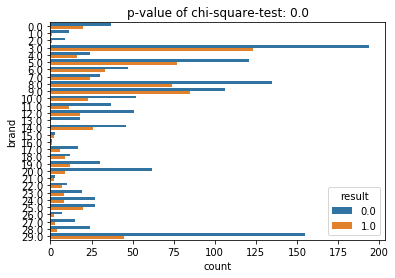

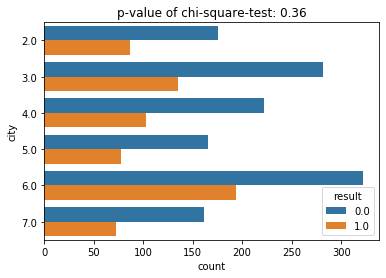

In [3]:
from scipy import stats

tf = transformation(raw_data).fill_na_columns()
data = tf.data

def chi_squere_test(data, column='city'):
    contingency_table = pd.crosstab(
    data['result'],
    data[column])
    return stats.chi2_contingency(contingency_table.values)[1]

columns = categorical_cols

for column in columns:
    sns.countplot(y=column, hue="result", orient='h', data=data)   
    plt.title(f'p-value of chi-square-test: {round(chi_squere_test(data, column), 2)}')
    plt.show()

## 3.2 Numerical Variables

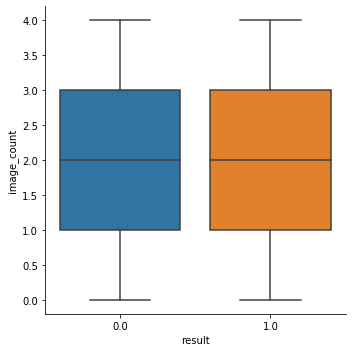

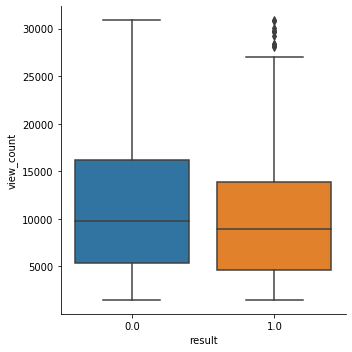

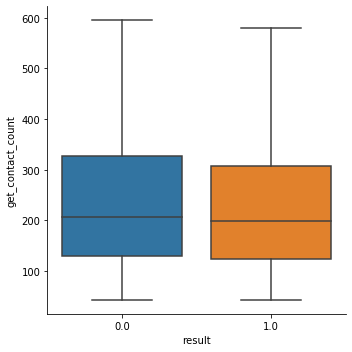

In [5]:
X, y = tf.create_X_y()

for column in numerical_cols:
    mask = IsolationForest(contamination=0.15).fit_predict(X[column].to_frame(), y) == 1
    new_data = data[mask]
    sns.catplot(x="result", y=column, kind="box", data=new_data)
    plt.show()

## 3.3 Pairwise Data Relationships

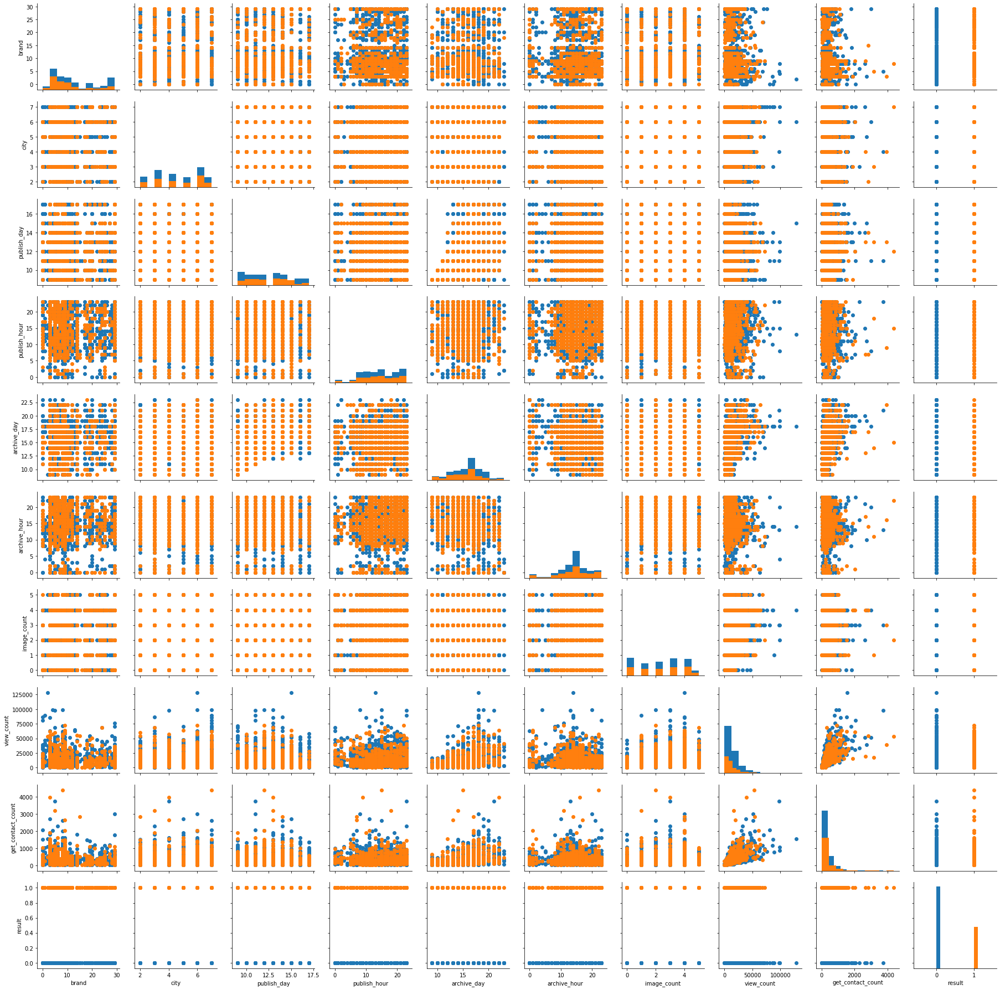

In [6]:
g = sns.PairGrid(data, hue='result')
g.map_diag(plt.hist)
g.map_offdiag(plt.scatter)

## 3.4 Chi-squre Test

([0, 1, 2, 3, 4, 5, 6, 7, 8], <a list of 9 Text xticklabel objects>)

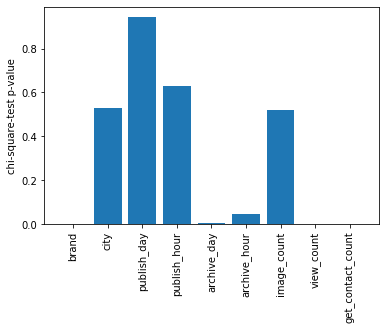

In [7]:
from sklearn.feature_selection import SelectKBest, chi2
x = SelectKBest(chi2, k=9)
X_new = x.fit_transform(X, y)
plt.bar(X.columns, x.pvalues_.tolist())
plt.ylabel('chi-square-test p-value')
plt.xticks(rotation=90)

## 3.5 Linear Regression Coefs

([0, 1, 2, 3, 4, 5, 6, 7, 8], <a list of 9 Text xticklabel objects>)

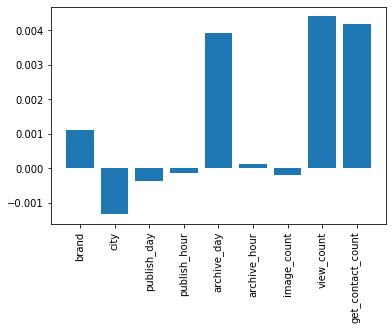

In [8]:
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LogisticRegression

X, y = transformation(raw_data).fill_na_columns().create_X_y()

X_scaled = StandardScaler().fit_transform(X)

clf = LogisticRegression(random_state=0).fit(X_scaled, y)

r = permutation_importance(clf, X_scaled, y,
                           n_repeats=30,
                           random_state=0)
plt.bar(X.columns, r.importances_mean)
plt.xticks(rotation=90)

## 3.6 Parallel Cordinate

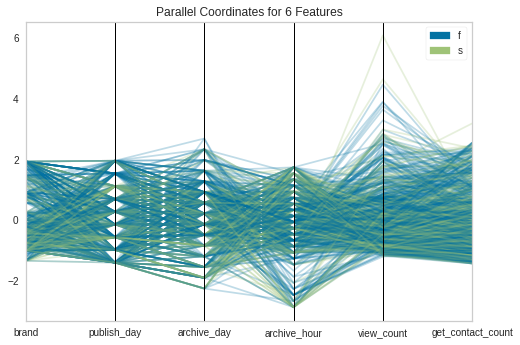

In [12]:
from yellowbrick.features import ParallelCoordinates

tf = transformation(raw_data).fill_na_columns().drop_columns(columns=['city', 'publish_hour', 'image_count'])
X, y = tf.create_X_y()

mask = IsolationForest(contamination=0.15).fit_predict(X[column].to_frame(), y) == 1
new_X = X[mask]
new_y = y[mask]

X_scaled = StandardScaler().fit_transform(new_X)

target_names = ['f', 's']

visualizer = ParallelCoordinates(
    classes=target_names, features=list(X.columns), sample=0.5, shuffle=True
)
visualizer.fit_transform(X_scaled, new_y)
visualizer.show()

## 3.7 Dimension Reduction Visualization

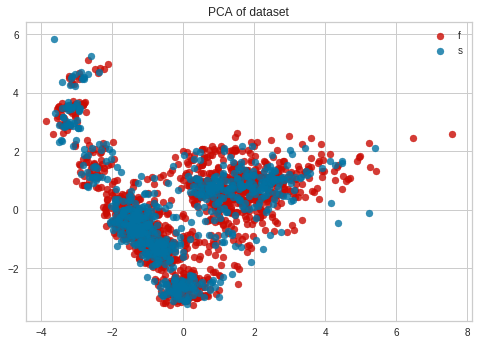

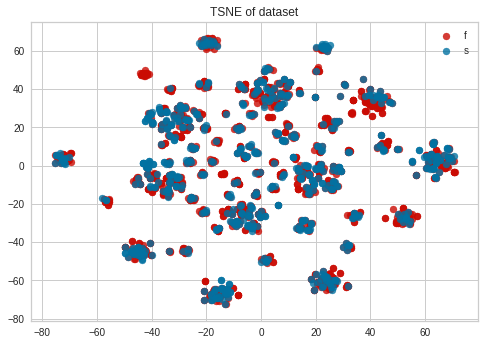

In [13]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

X, y = tf.cats_to_one_hot(columns=['brand'] + day_cols + ['archive_day']).create_X_y()

X_scaled = StandardScaler().fit_transform(X)

X = X.values

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

tsne = TSNE(n_components=2)
X_tsne = tsne.fit_transform(X_scaled)

plt.figure()
colors = ['r', 'b']

for color, i, target_name in zip(colors, [0, 1], target_names):
    plt.scatter(X_pca[y == i, 0], X_pca[y == i, 1], color=color, alpha=.8,
                label=target_name)

plt.legend(loc='best', shadow=False, scatterpoints=1)
plt.title('PCA of dataset')

plt.figure()
for color, i, target_name in zip(colors, [0, 1], target_names):
    plt.scatter(X_tsne[y == i, 0], X_tsne[y == i, 1], alpha=.8, color=color,
                label=target_name)
plt.legend(loc='best', shadow=False, scatterpoints=1)
plt.title('TSNE of dataset')
plt.show()

# 4. Classification
* modeling and evaluation
* optimiziation
* learning curve 
* outlier detection

## 4.1 Train and Evaluate Model with Cross Validation

cross val score on all data 0.6457222222222223
accuracy on test set 0.6266666666666667
f1 on test set 0.24324324324324328
roc auc on test set 0.5149999999999999


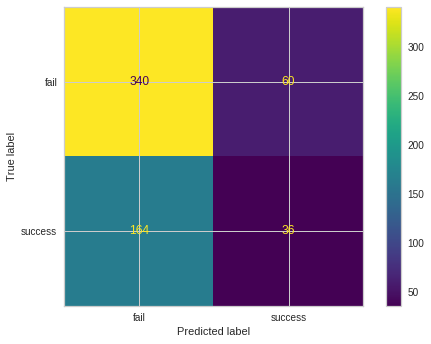

In [14]:
from sklearn.model_selection import ShuffleSplit
from sklearn.metrics import plot_confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score


tf = transformation(raw_data).drop_columns(columns=['city', 'publish_hour', 'image_count'])
tf = tf.cats_to_one_hot(columns=['brand'] + day_cols + ['archive_day'])
X, y = tf.create_X_y()

cv = ShuffleSplit(n_splits=30, test_size=0.3, random_state=0)

def cross_validate_test(X, y, clf, metric=accuracy_score, outlier_detection=False):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

    pipeline = make_pipeline(KNNImputer(n_neighbors=7), StandardScaler(), clf)
    scores = cross_val_score(
        pipeline, X, y, cv=cv, scoring=make_scorer(metric), n_jobs=-1)

    pipeline.fit(X_train, y_train)
    y_pred = pipeline.predict(X_test)

    print('cross val score on all data', np.mean(scores))
    if not outlier_detection:
        plot_confusion_matrix(pipeline, X_test, y_test,
                            display_labels=['fail', 'success'])
                
    print('accuracy on test set', accuracy_score(y_test, y_pred))
    print('f1 on test set', f1_score(y_test, y_pred))
    print('roc auc on test set', roc_auc_score(y_test, y_pred))

cross_validate_test(X, y, RandomForestClassifier(n_estimators=100), metric=accuracy_score)

## 4.2 Random Forest max_depth Parameter Optimization 

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done 570 out of 1140 | elapsed:  1.9min remaining:  1.9min
[Parallel(n_jobs=-1)]: Done 1140 out of 1140 | elapsed:  3.8min finished


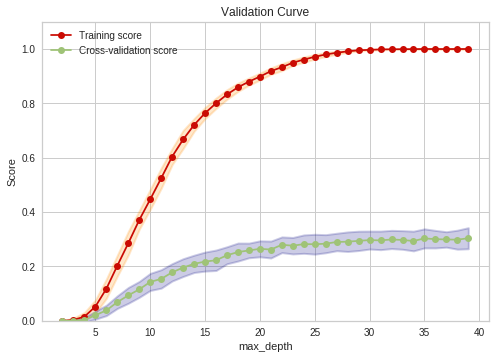

In [17]:
from sklearn.model_selection import validation_curve

tf = transformation(raw_data).drop_columns(columns=['city', 'publish_hour', 'image_count'])
tf = tf.cats_to_one_hot(columns=['brand'] + day_cols + ['archive_day'])
X, y = tf.create_X_y()

def plot_validation_curve(parameter="randomforestclassifier__max_depth"):
    plt.figure()
    pipe = make_pipeline(KNNImputer(n_neighbors=7), StandardScaler(), RandomForestClassifier(
        n_estimators=100, n_jobs=-1))

    param_range = [i for i in range(2, 40)]

    train_scores, test_scores = validation_curve(
        pipe, X, y, param_name="randomforestclassifier__max_depth", param_range=param_range,
        scoring=make_scorer(f1_score), n_jobs=-1, cv=cv, verbose=2)

    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    plt.title("Validation Curve")
    plt.xlabel("max_depth")
    plt.ylabel("Score")
    plt.ylim(0.0, 1.1)
    lw = 2
    plt.plot(param_range, train_scores_mean, 'o-', color="r",
            label="Training score")
    plt.fill_between(param_range, train_scores_mean - train_scores_std,
                    train_scores_mean + train_scores_std, alpha=0.2,
                    color="darkorange", lw=lw)
    plt.plot(param_range, test_scores_mean, 'o-', color="g",
            label="Cross-validation score")
    plt.fill_between(param_range, test_scores_mean - test_scores_std,
                    test_scores_mean + test_scores_std, alpha=0.2,
                    color="navy", lw=lw)
    plt.legend(loc="best")
    plt.show()

plot_validation_curve()

## 4.3 Learning Curve

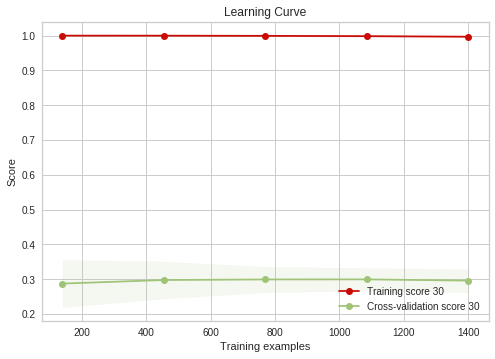

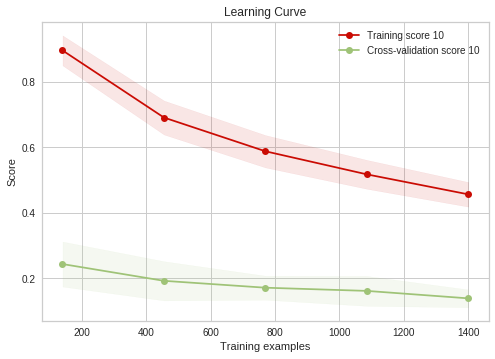

In [18]:
from sklearn.model_selection import learning_curve

def plot_learning_curve(max_depth=30):
    plt.figure()
    pipe = make_pipeline(KNNImputer(n_neighbors=7), StandardScaler(), RandomForestClassifier(
    n_estimators=100, max_depth=max_depth, n_jobs=-1))

    train_sizes, train_scores, test_scores, _, _ = \
        learning_curve(pipe, X, y, cv=cv, n_jobs=-1,
                       train_sizes=np.linspace(.1, 1.0, 5),
                       scoring=make_scorer(f1_score),
                       return_times=True
                       )

    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                      train_scores_mean + train_scores_std, alpha=0.1,
                      color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                      test_scores_mean + test_scores_std, alpha=0.1,
                      color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
              label=f"Training score {max_depth}")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
              label=f"Cross-validation score {max_depth}")

    plt.title('Learning Curve')
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    plt.legend(loc="best")
    plt.show()

plot_learning_curve(max_depth=30)
plot_learning_curve(max_depth=10)

## 4.4 Outlier Removal

In [20]:
from sklearn.base import BaseEstimator, clone
from sklearn.pipeline import TransformerMixin


class WithoutOutliersClassifier(BaseEstimator, TransformerMixin):

    def __init__(self, outlier_detector, classifier):
        self.outlier_detector = outlier_detector
        self.classifier = classifier

    def fit(self, X, y):
        self.outlier_detector_ = clone(self.outlier_detector)
        mask = self.outlier_detector_.fit_predict(X, y) == 1
        print(np.unique(mask, return_counts=True))
        self.classifier_ = clone(self.classifier).fit(X[mask], y[mask])
        return self

    def predict(self, X):
        return self.classifier_.predict(X)

clf = RandomForestClassifier(
    n_estimators=100, max_depth=30, n_jobs=-1)

outlier_detector = IsolationForest(contamination=0.15)
without_outliers_classifier = WithoutOutliersClassifier(outlier_detector, clf)
cross_validate_test(X, y, without_outliers_classifier, metric=f1_score, outlier_detection=True)

(array([False,  True]), array([ 210, 1190]))
cross val score on all data 0.30016655333371955
accuracy on test set 0.645
f1 on test set 0.3061889250814332
roc auc on test set 0.5398532324412167


# 5. Model interpretation

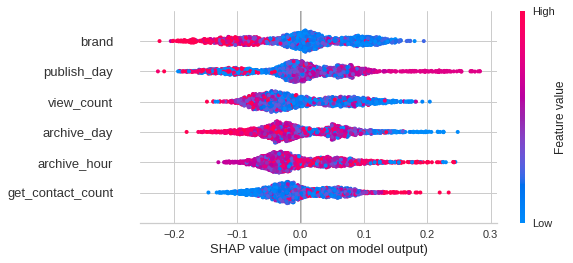

In [22]:
import shap

tf = transformation(raw_data).drop_columns(columns=['city', 'publish_hour', 'image_count'])
X, y = tf.create_X_y()

pipe = make_pipeline(KNNImputer(n_neighbors=7), StandardScaler())
pipe.fit(X)

X_train = pipe.transform(X)

clf = RandomForestClassifier(
    n_estimators=100, max_depth=30, n_jobs=-1)

clf.fit(X_train, y)
explainer = shap.TreeExplainer(clf)

shap_values = explainer.shap_values(X_train)[1]

shap.summary_plot(shap_values, X_train, X.columns.tolist())
# shap.summary_plot(shap_values, X_train,  X.columns.tolist(), plot_type="bar")